In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("ticks")

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor

%matplotlib inline

INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Smoothing
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Albania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Andorra
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Estonia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Iceland
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Latvia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Lithuania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing New Zealand
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Singapore
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Slovakia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Masking


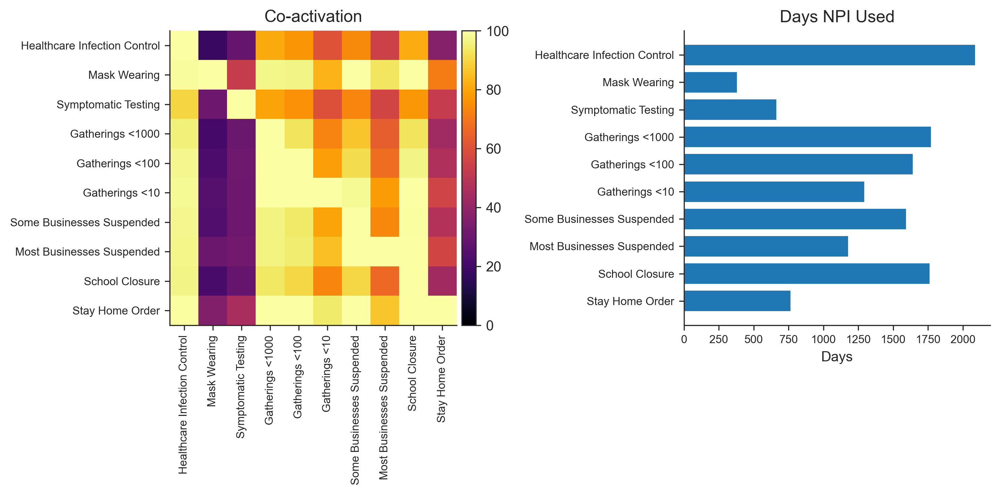

In [3]:
dp = DataPreprocessor()
data = dp.preprocess_data("data_final.csv")

In [4]:
# data.filter_region_min_deaths(100)

In [9]:
def mask_region_ends(d, region, ndays=10):
    i = d.Rs.index(region)
    d.Active.mask[i,-ndays:] = True
    d.Confirmed.mask[i,-ndays:] = True
    d.Deaths.mask[i,-ndays:] = True
    d.NewDeaths.mask[i,-ndays:] = True
    d.NewCases.mask[i,-ndays:] = True

for region in data.Rs:
    mask_region_ends(data, region, 7)

In [10]:
with cm_effect.models.CMActive_Final(data) as model:
    model.build_model()

/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedCases contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)


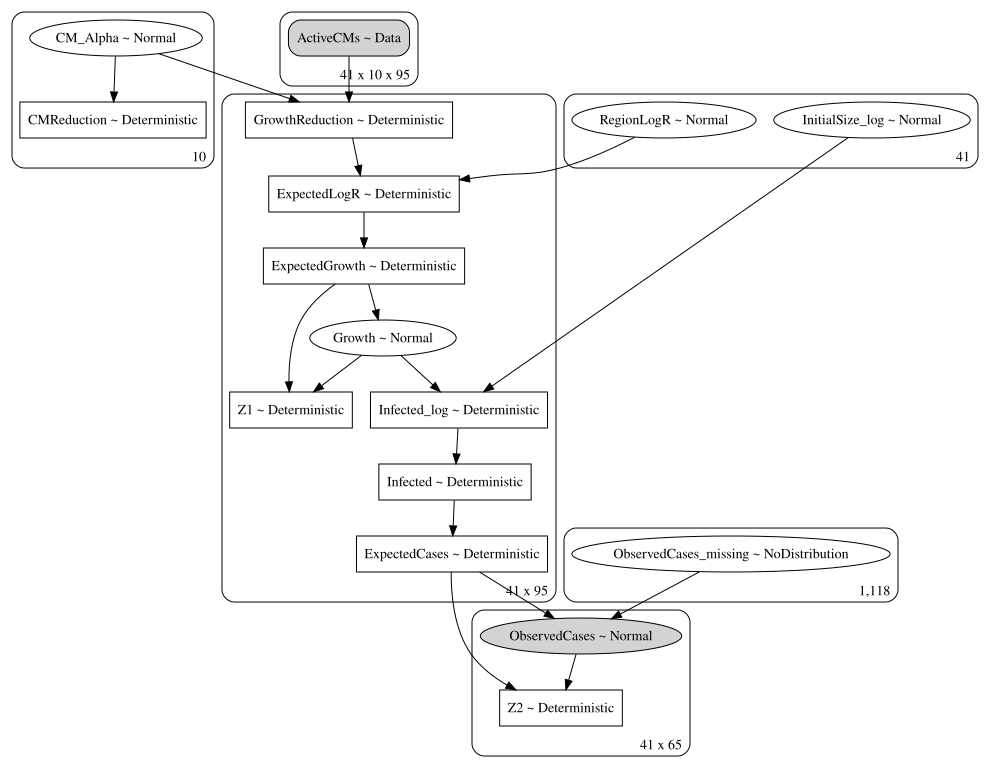

In [11]:
pm.model_to_graphviz(model).render("model-active-final")
pm.model_to_graphviz(model)

In [12]:
with model.model:
    model.trace = pm.sample(2000, chains=2, target_accept=0.95)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [ObservedCases_missing, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [ObservedCases_missing, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [46:32<00:00,  1.79draws/s] 
The chain reached the maximum tree depth. Increase max_treedepth, increase target_accept or reparameterize.
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

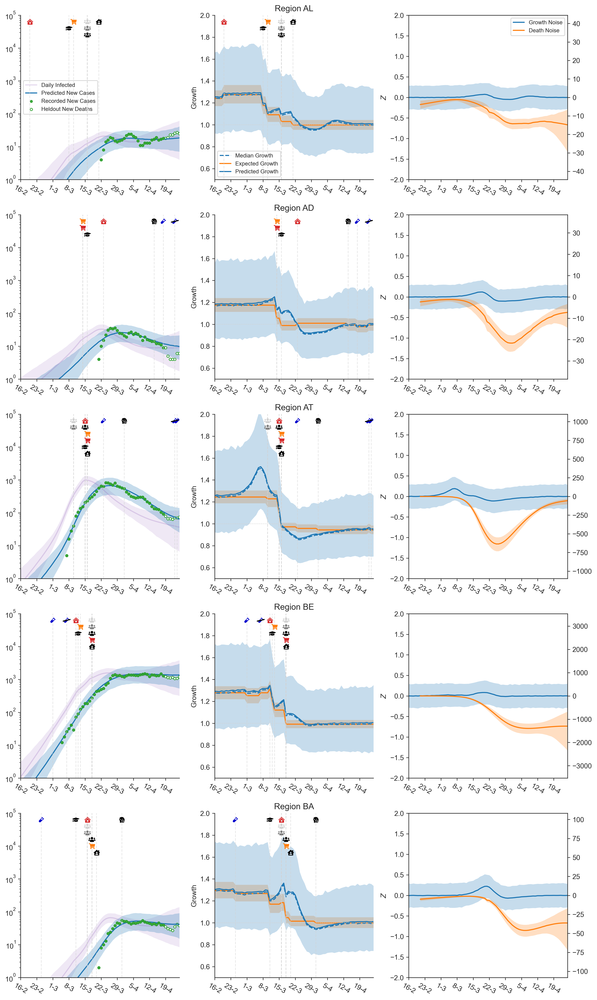

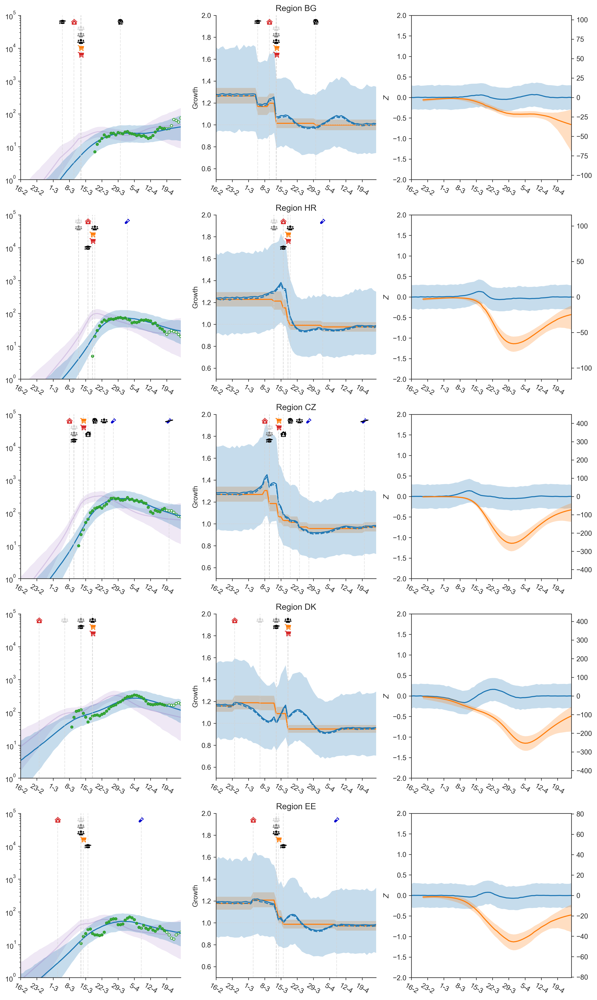

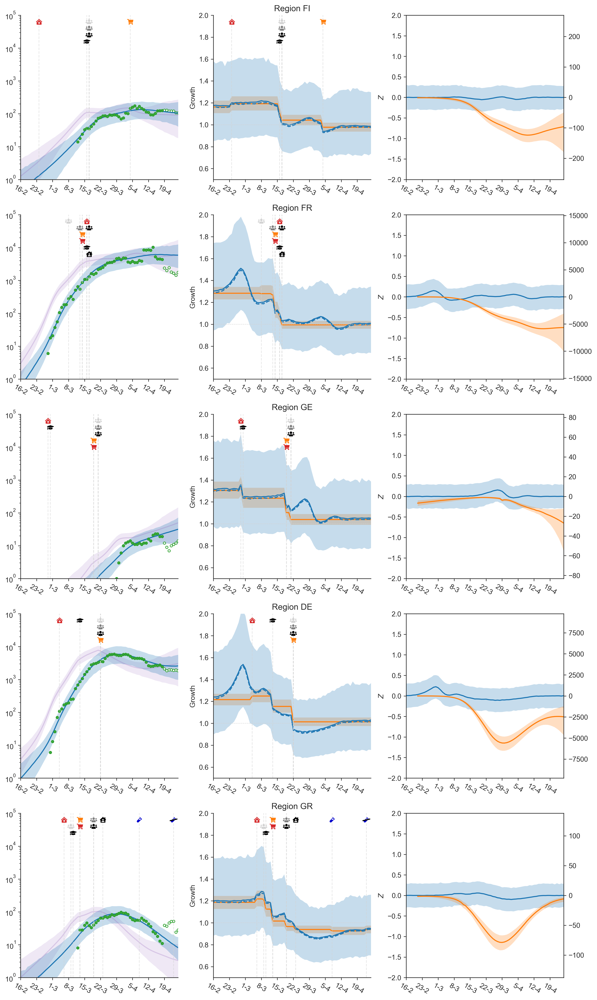

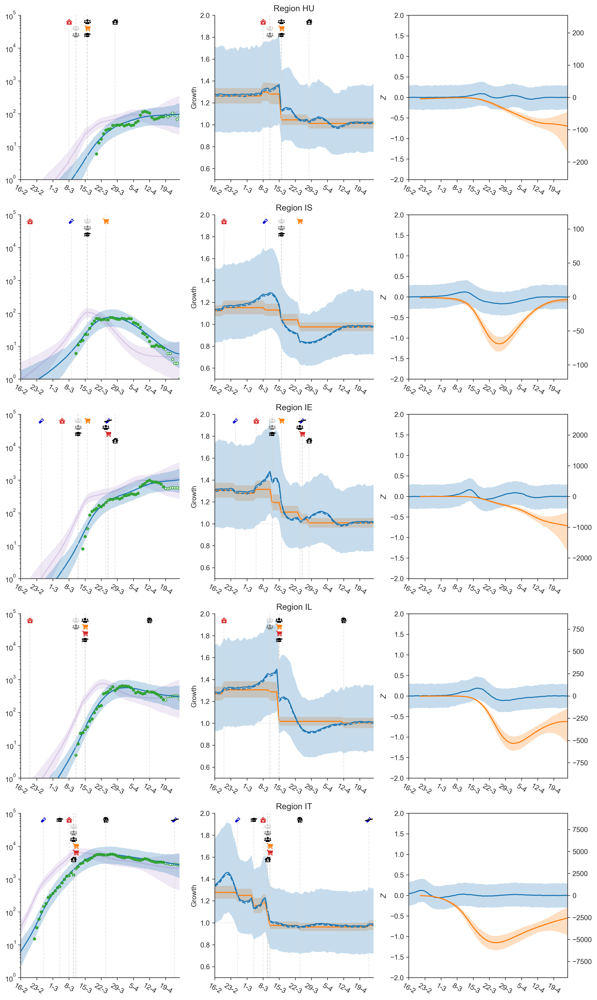

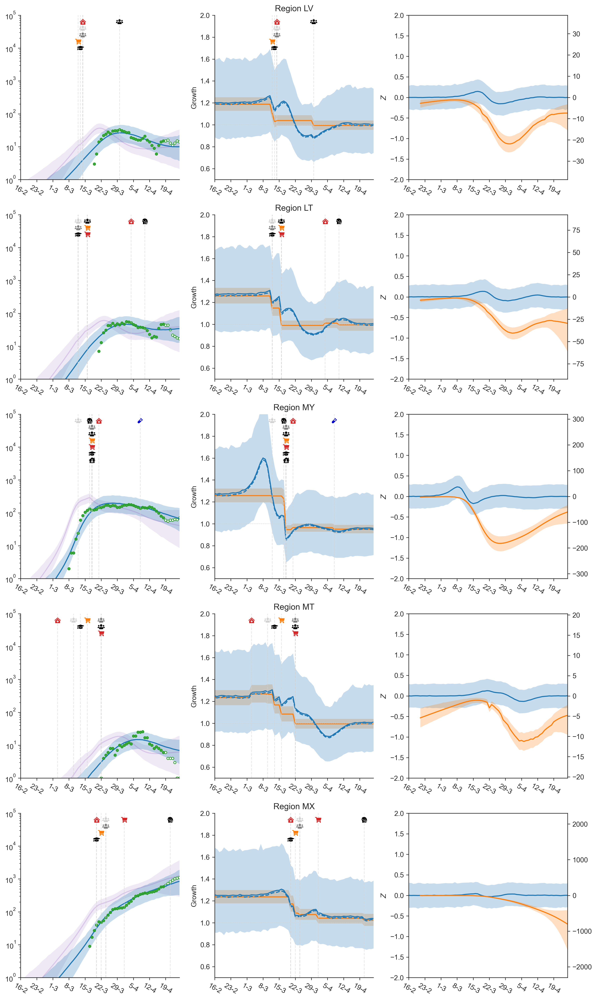

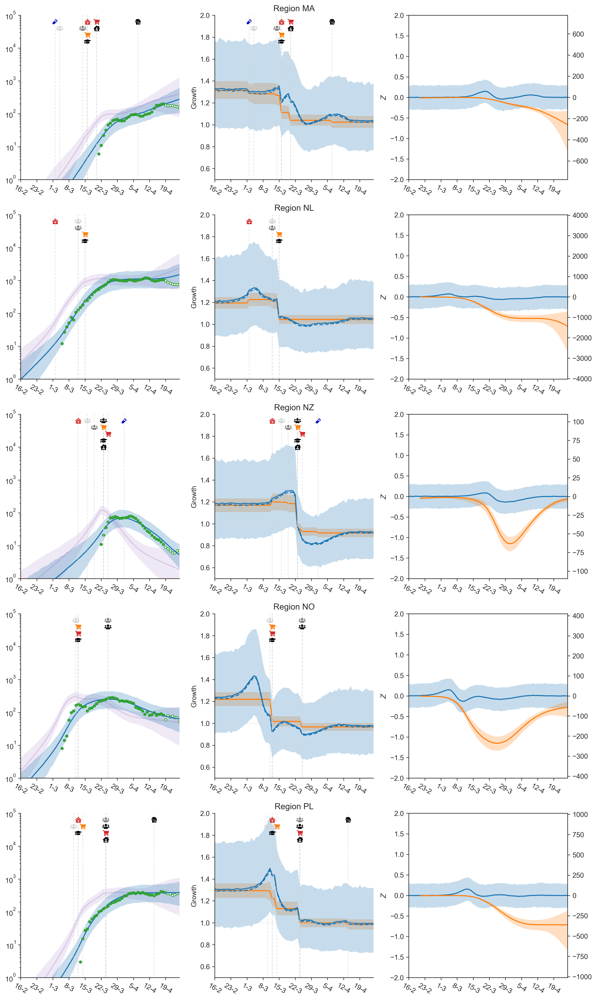

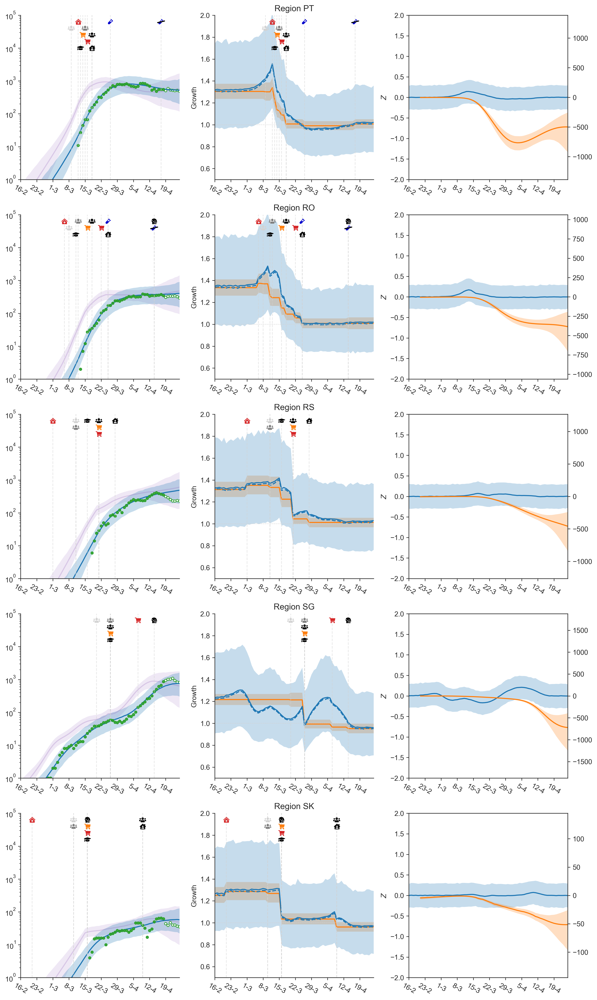

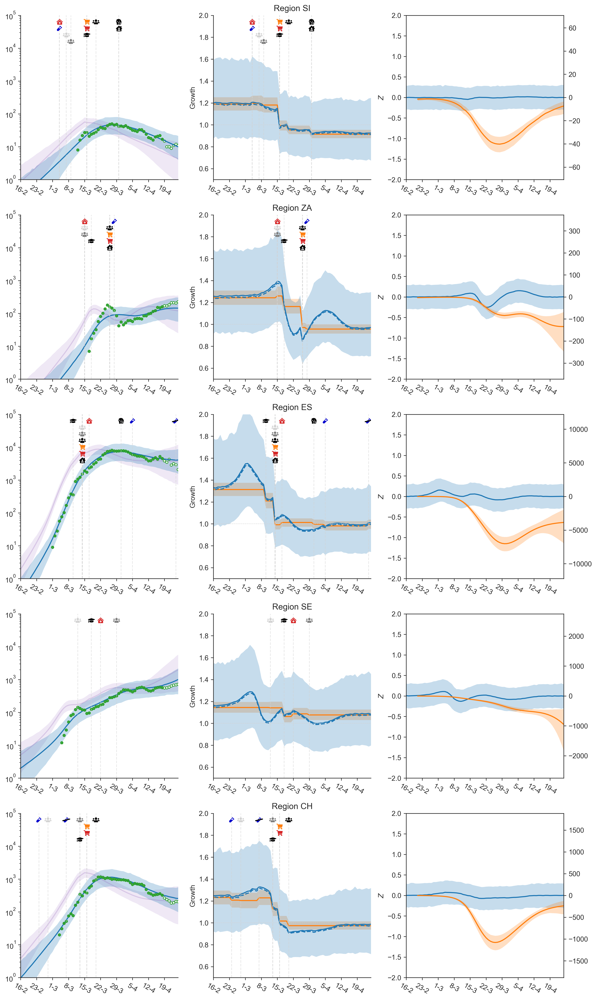

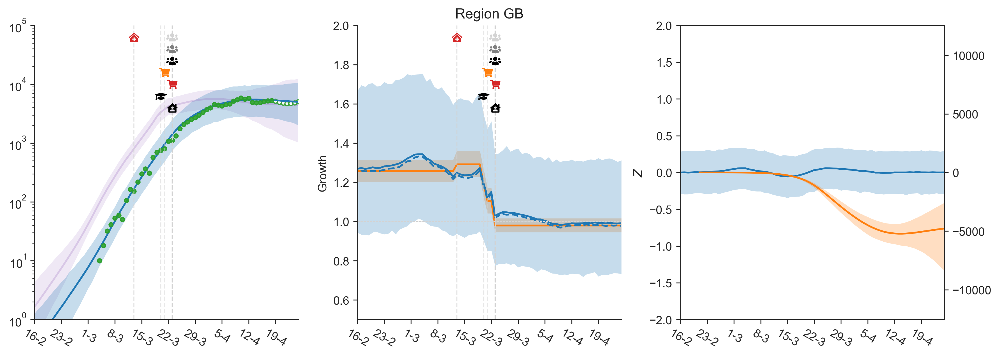

In [16]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]

model.plot_region_predictions(cm_plot_style)

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

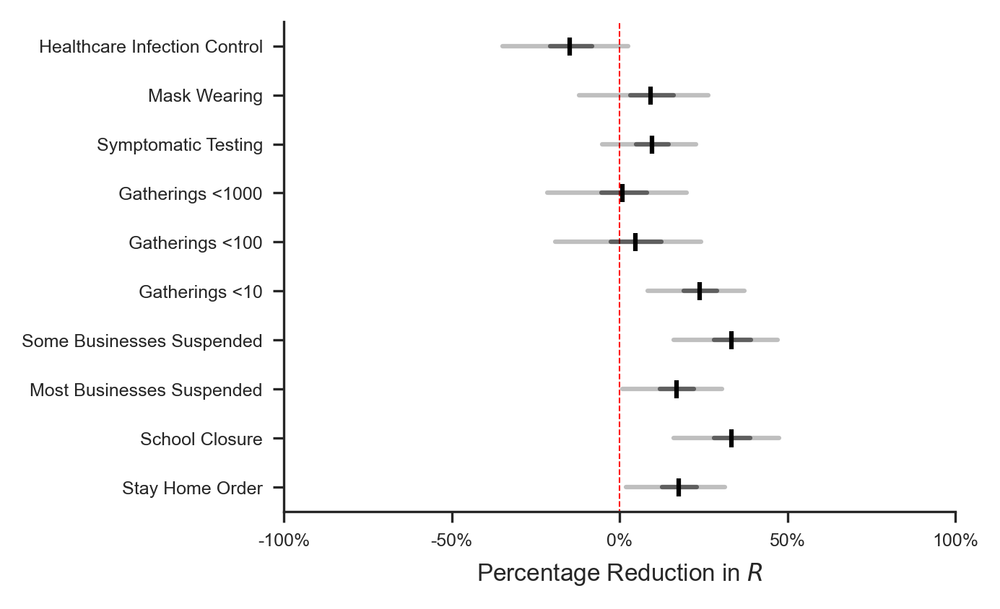

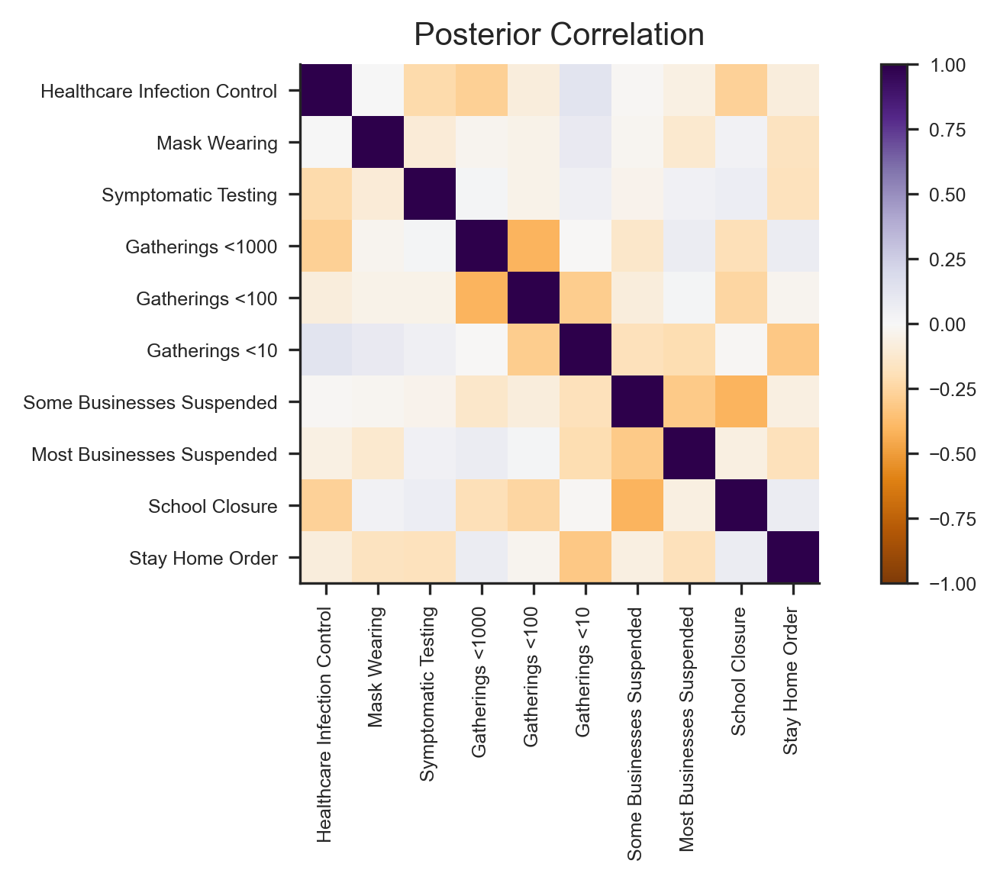

In [17]:
model.plot_effect()

In [36]:
for i, cm in enumerate(model.d.CMs):
    print(f"CM: {cm} mean: {np.mean(model.trace['CMReduction'][:, i]):.3f} [{np.percentile(model.trace['CMReduction'][:, i], 2.5):.3f}, {np.percentile(model.trace['CMReduction'][:, i], 97.5):.3f}]")

CM: Healthcare Infection Control mean: 1.147 [0.973, 1.349]
CM: Mask Wearing mean: 0.908 [0.735, 1.122]
CM: Symptomatic Testing mean: 0.904 [0.772, 1.052]
CM: Gatherings <1000 mean: 0.991 [0.800, 1.214]
CM: Gatherings <100 mean: 0.954 [0.758, 1.191]
CM: Gatherings <10 mean: 0.761 [0.627, 0.916]
CM: Some Businesses Suspended mean: 0.666 [0.528, 0.838]
CM: Most Businesses Suspended mean: 0.831 [0.694, 0.991]
CM: School Closure mean: 0.667 [0.524, 0.839]
CM: Stay Home Order mean: 0.824 [0.685, 0.980]


In [22]:
np.mean(model.trace["CMReduction"][:, 0])

1.1474681853633302

In [50]:
with cm_effect.models.CMActive_Final_NB(data) as model2:
    model2.build_model()

Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AL
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AD
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for AT
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BE
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BA
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for BG
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for HR
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for CZ
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for DK
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for EE
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for FI
Skipped day [(19, 4), (20, 4), (21, 4), (22, 4), (23, 4), (24, 4), (25, 4)] for FR
Skip

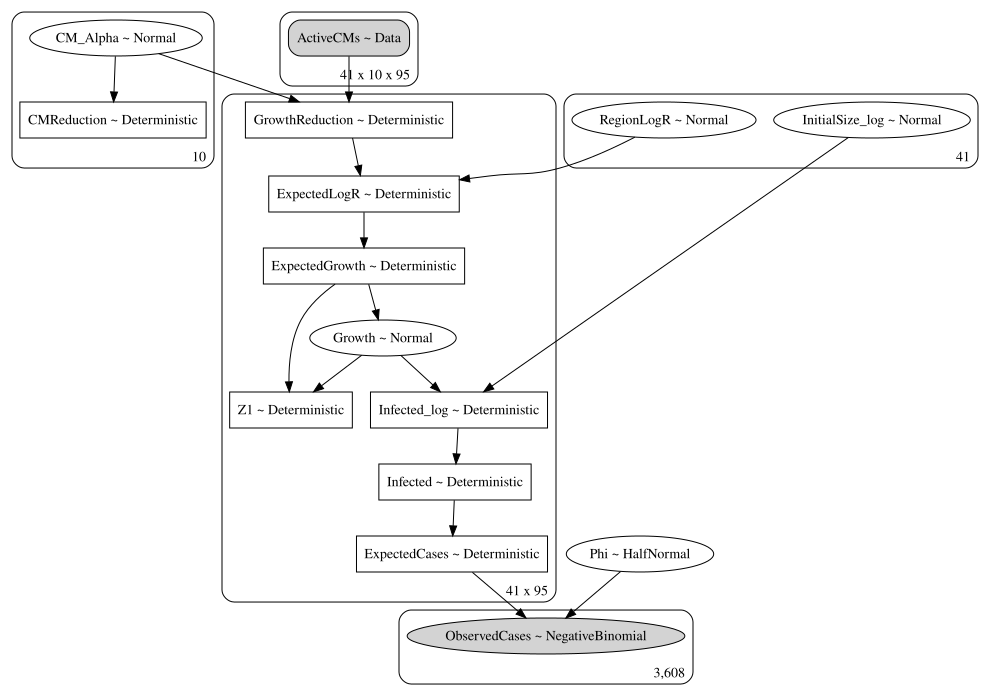

In [52]:
pm.model_to_graphviz(model2).render("model-active-final-alt")
pm.model_to_graphviz(model2)

In [54]:
with model2.model:
    model2.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, Growth, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [34:02<00:00,  2.45draws/s]


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

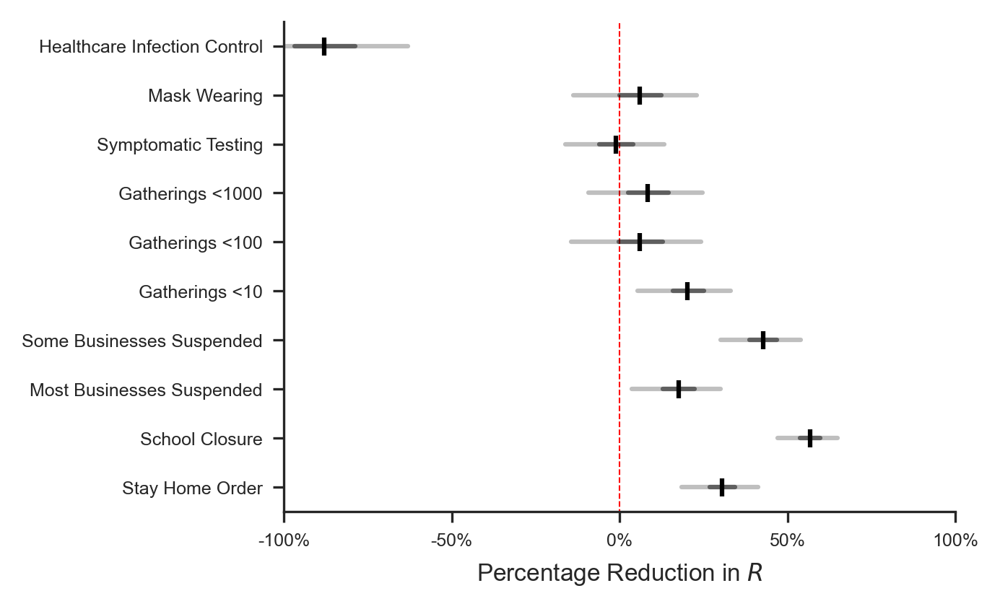

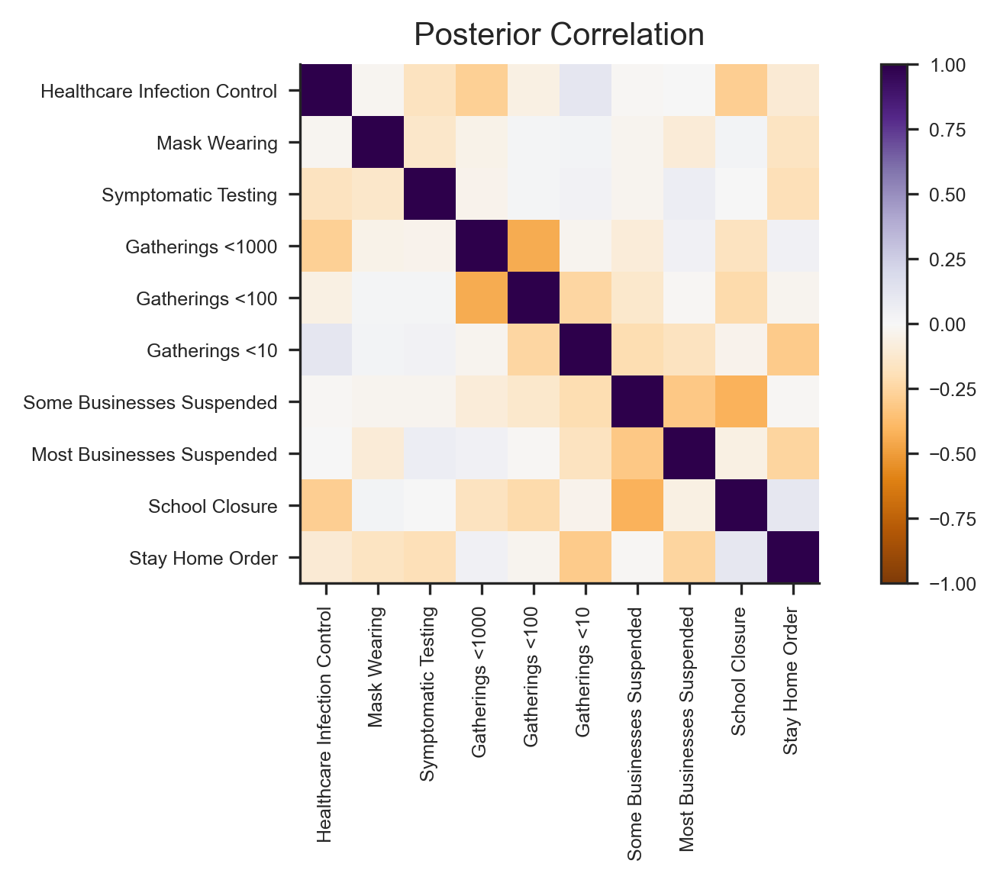

In [59]:
model2.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

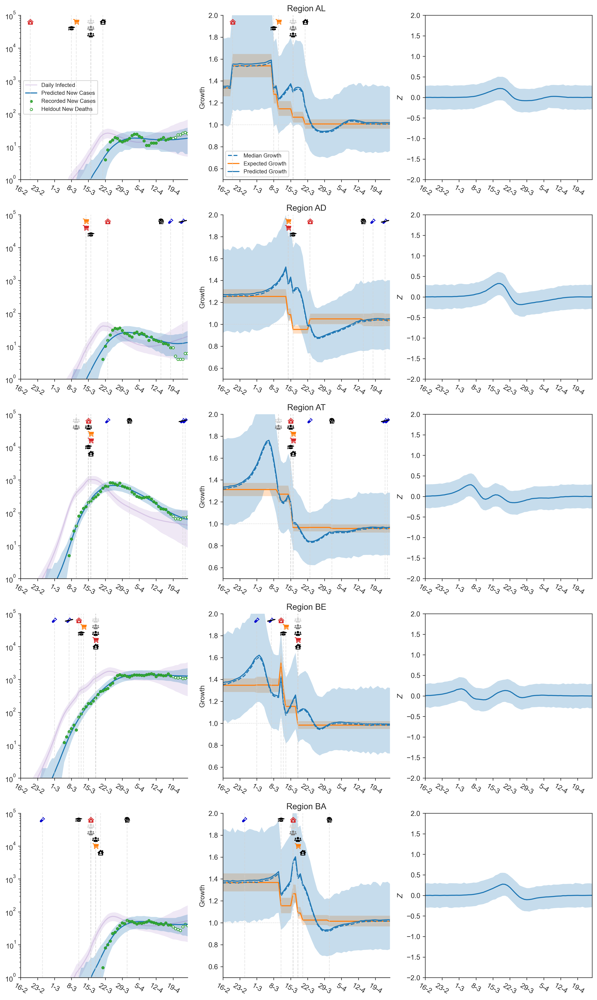

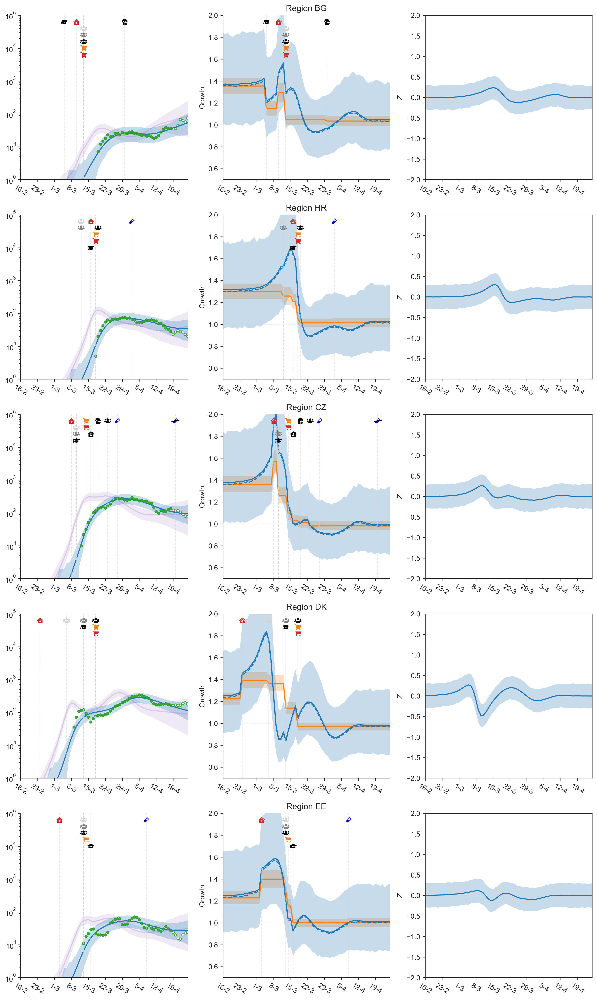

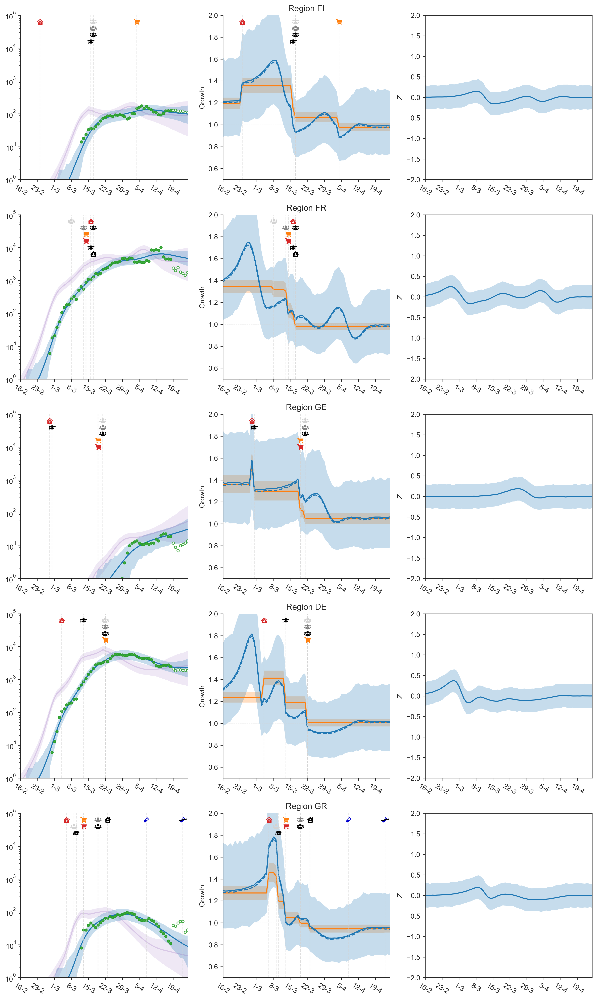

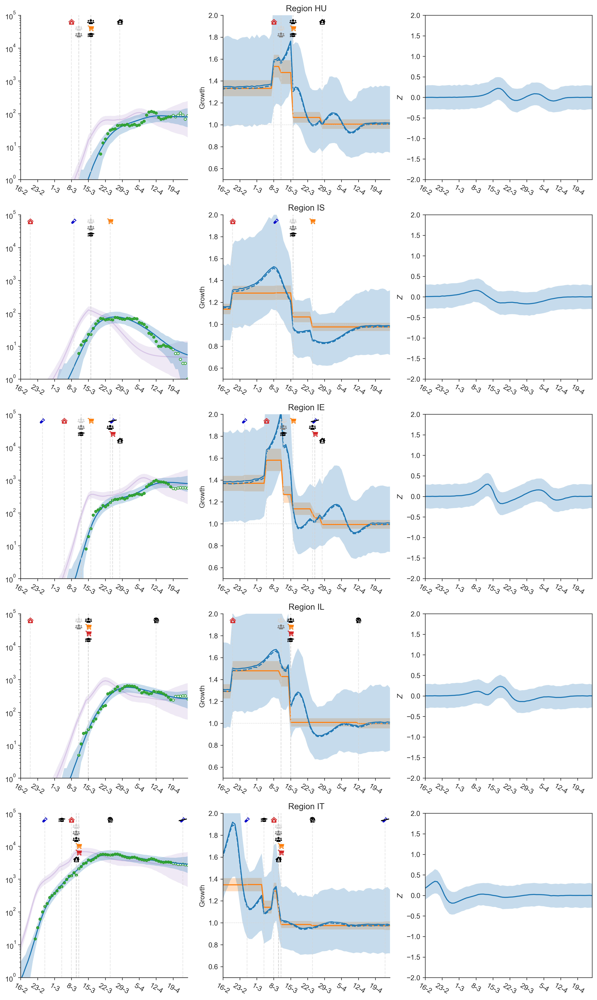

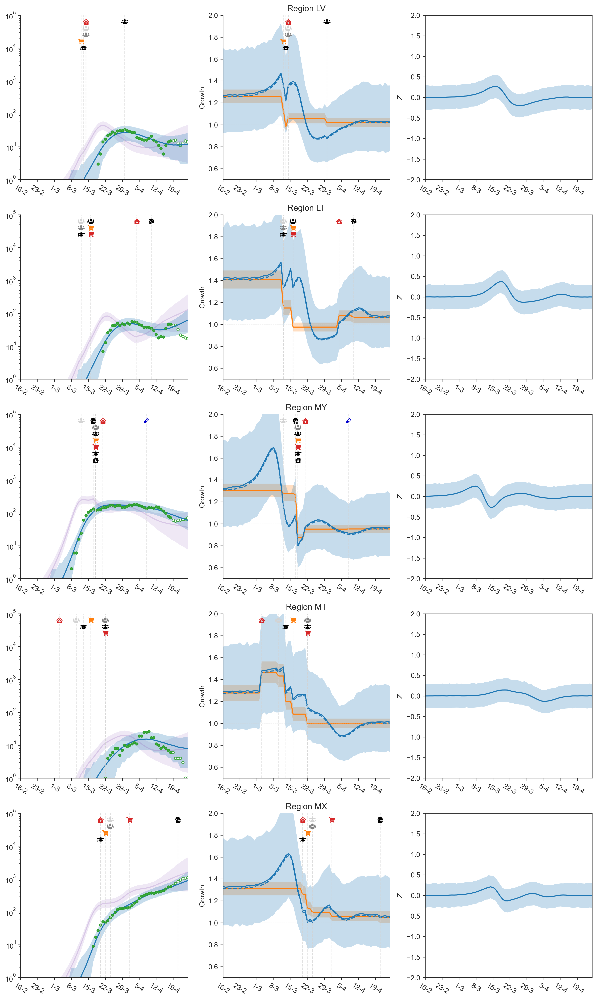

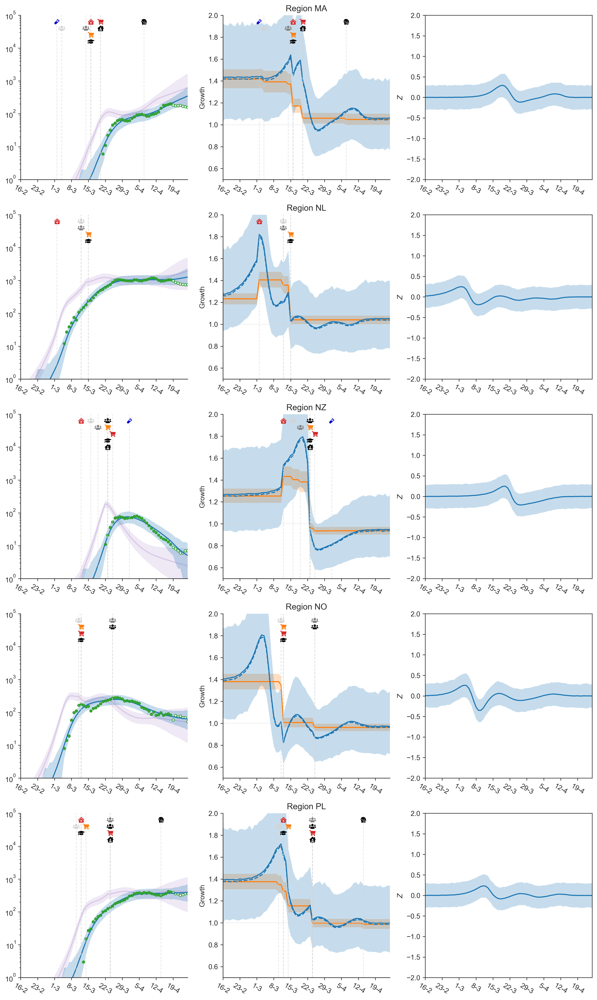

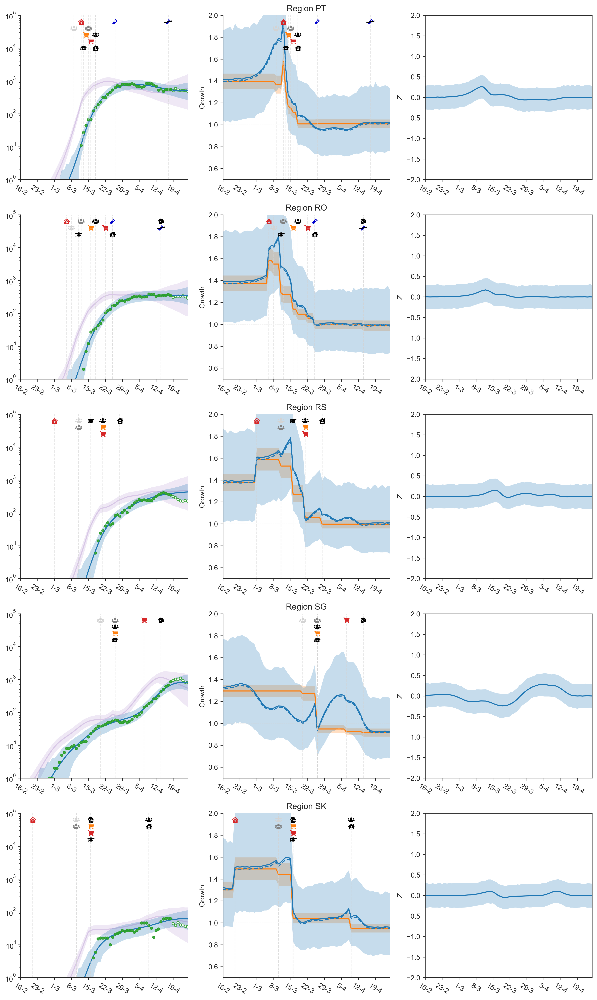

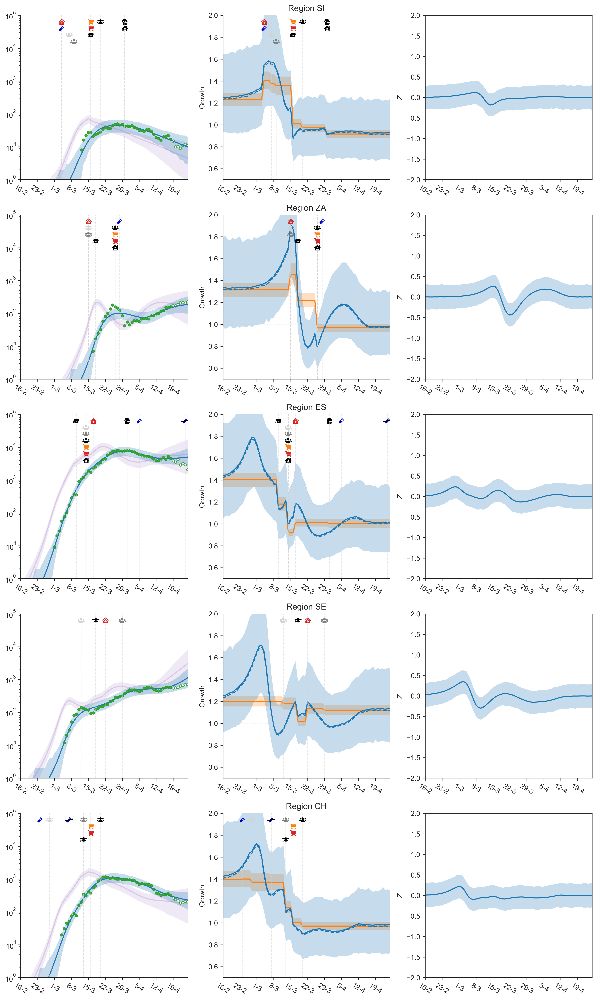

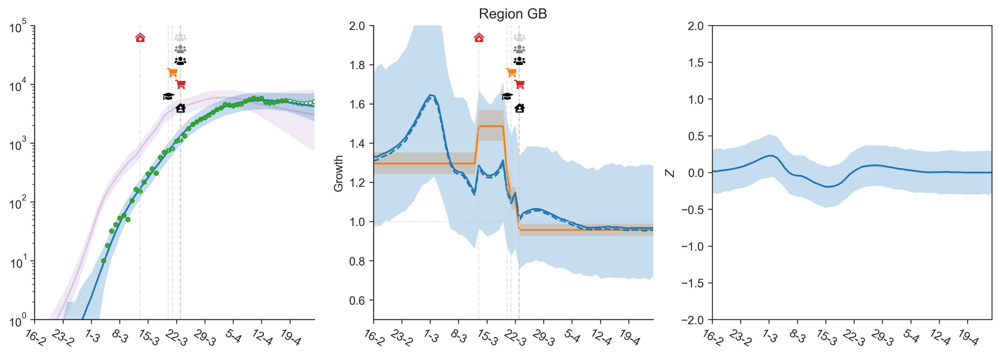

In [60]:
model2.plot_region_predictions(cm_plot_style)